In [ ]:
import geopandas as gpd
import os


DATA_PATH = "/mnt/d/data/hackathon/"

,SAL_CODE21,SAL_NAME21,STE_CODE21,STE_NAME21,AUS_CODE21,AUS_NAME21,AREASQKM21,LOCI_URI21,SHAPE_Leng,SHAPE_Area,geometry
0,10001,Aarons Pass,1,New South Wales,AUS,Australia,82.7639,http://linked.data.gov.au/dataset/asgsed3/SAL/...,0.554241,0.007975,"POLYGON ((149.82477 -32.84384, 149.83271 -32.8..."
1,10002,Abbotsbury,1,New South Wales,AUS,Australia,4.9788,http://linked.data.gov.au/dataset/asgsed3/SAL/...,0.123051,0.000485,"POLYGON ((150.86523 -33.88264, 150.86479 -33.8..."
2,10003,Abbotsford (NSW),1,New South Wales,AUS,Australia,1.0180,http://linked.data.gov.au/dataset/asgsed3/SAL/...,0.053423,0.000099,"POLYGON ((151.13472 -33.85492, 151.13445 -33.8..."
3,10004,Abercrombie,1,New South Wales,AUS,Australia,2.9775,http://linked.data.gov.au/dataset/asgsed3/SAL/...,0.097338,0.000289,"POLYGON ((149.55192 -33.3928, 149.55148 -33.39..."
4,10005,Abercrombie River,1,New South Wales,AUS,Australia,127.1701,http://linked.data.gov.au/dataset/asgsed3/SAL/...,0.848903,0.012397,"POLYGON ((149.25562 -33.96535, 149.25563 -33.9..."


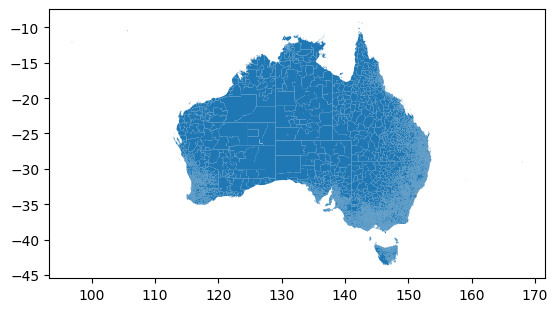

In [4]:
shapes_gpd = gpd.read_file(os.path.join(DATA_PATH, "SAL_2021_AUST_GDA2020_SHP.zip"))
shapes_gpd = shapes_gpd.dropna(subset=['geometry'])
shapes_gpd.plot()
shapes_gpd.head()

In [ ]:
def geom_to_coords(geom):
    if geom is None:
        return None
    if geom.geom_type == "Polygon":
        return [list(coord) for coord in geom.exterior.coords]
    elif geom.geom_type == "MultiPolygon":
        # Take exterior coords of each polygon in the multipolygon
        return [[list(coord) for coord in poly.exterior.coords] for poly in geom.geoms]
    else:
        return None

shapes_gpd["geometry_list"] = shapes_gpd["geometry"].apply(geom_to_coords)

<Axes: >

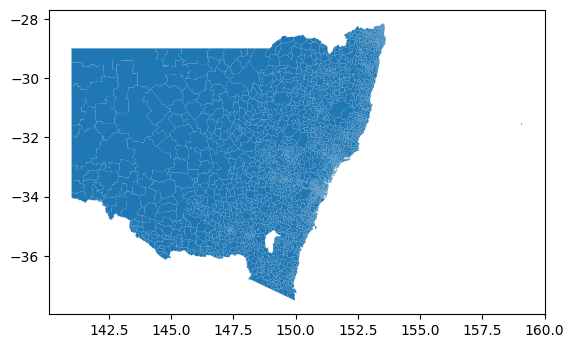

In [4]:
nsw_shapes_gpd = shapes_gpd[shapes_gpd["STE_NAME21"] == "New South Wales"]
nsw_shapes_gpd.plot()

<Axes: >

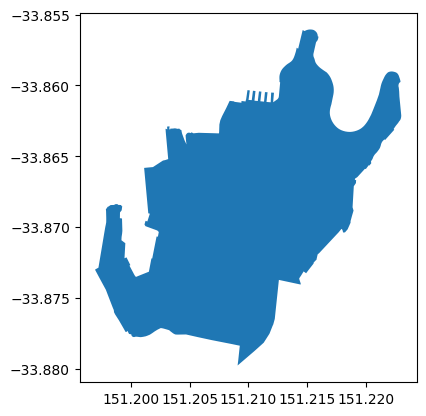

In [5]:
sydney_shapes_gpd = nsw_shapes_gpd[nsw_shapes_gpd["SAL_NAME21"] == "Sydney"]
sydney_shapes_gpd.plot()

<Axes: >

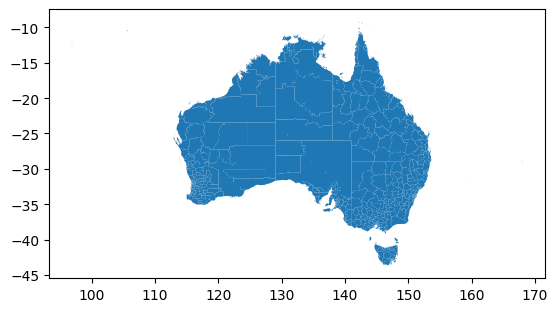

In [6]:
lga_shapes_gpd = gpd.read_file(os.path.join(DATA_PATH, "LGA_2024_AUST_GDA2020.zip"))
lga_shapes_gpd.plot()

<Axes: >

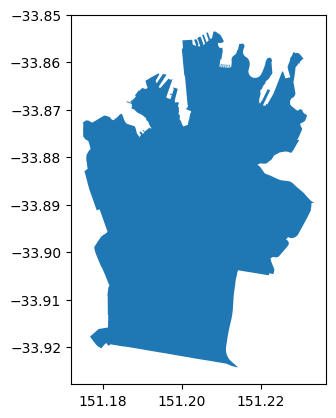

In [8]:
sydney_lga_shapes_gpd = lga_shapes_gpd.loc[lga_shapes_gpd["LGA_NAME24"]=="Sydney"]
sydney_lga_shapes_gpd.plot()

In [5]:
import json
from pprint import pprint
import pandas as pd

postcode_df = pd.read_csv(os.path.join(DATA_PATH, "australian_postcodes.csv"))
postcode_df.loc[:, "locality"] = postcode_df["locality"].str.lower()
postcode_to_locality = dict(zip(postcode_df["locality"], postcode_df["postcode"]))
# print(postcode_to_locality)

custom_json = json.load(open(os.path.join(DATA_PATH, "LocalGovernmentArea_EPSG4326.json")))
custom_geojson = custom_json["LocalGovernmentArea"]

for feat in custom_geojson["features"]:
    # print(feat["properties"])
    _postcode = postcode_to_locality.get(feat["properties"]["lganame"].lower(), None)
    feat["properties"].update({"postcode": _postcode})
print(custom_geojson["features"][0]["properties"]["postcode"])
    

2148


In [14]:
import plotly.express as px

# Extract all LGA names from the GeoJSON features
locations = [feature["properties"]["postcode"] for feature in custom_geojson["features"] if feature["properties"]["postcode"]]

# Create a dummy color array (replace with your own data if available)
color = []
for _loc in locations:
    if _loc == 2077:
        _color = 100
    else:
        _color = 1
    color.append(_color)

fig = px.choropleth_map(
    geojson=custom_geojson,
    locations=locations,
    featureidkey="properties.postcode",
    color=color,
    center={"lat": -33.8688, "lon": 151.2093},  # Center on Sydney
    zoom=7,
    opacity=0.5,
)
fig.update_layout(width=600, height=600)
fig.show()